In [1]:
import numpy as np
import pandas as pd
import sklearn
import scipy.integrate as spi  
import pylab as pl

In [2]:
df = pd.read_csv("uci-news-aggregator.csv")

In [3]:
df

,ID,TITLE,URL,PUBLISHER,CATEGORY,STORY,HOSTNAME,TIMESTAMP
0,1,"Fed official says weak data caused by weather,...",http://www.latimes.com/business/money/la-fi-mo...,Los Angeles Times,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.latimes.com,1394470370698
1,2,Fed's Charles Plosser sees high bar for change...,http://www.livemint.com/Politics/H2EvwJSK2VE6O...,Livemint,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.livemint.com,1394470371207
2,3,US open: Stocks fall after Fed official hints ...,http://www.ifamagazine.com/news/us-open-stocks...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371550
3,4,"Fed risks falling 'behind the curve', Charles ...",http://www.ifamagazine.com/news/fed-risks-fall...,IFA Magazine,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.ifamagazine.com,1394470371793
4,5,Fed's Plosser: Nasty Weather Has Curbed Job Gr...,http://www.moneynews.com/Economy/federal-reser...,Moneynews,b,ddUyU0VZz0BRneMioxUPQVP6sIxvM,www.moneynews.com,1394470372027
...,...,...,...,...,...,...,...,...
422414,422933,Surgeons to remove 4-year-old's rib to rebuild...,http://www.cbs3springfield.com/story/26378648/...,WSHM-TV,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.cbs3springfield.com,1409229190251
422415,422934,Boy to have surgery on esophagus after battery...,http://www.wlwt.com/news/boy-to-have-surgery-o...,WLWT Cincinnati,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.wlwt.com,1409229190508
422416,422935,Child who swallowed battery to have reconstruc...,http://www.newsnet5.com/news/local-news/child-...,NewsNet5.com,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.newsnet5.com,1409229190771
422417,422936,Phoenix boy undergoes surgery to repair throat...,http://www.wfsb.com/story/26368078/phoenix-boy...,WFSB,m,dpcLMoJD69UYMXMxaoEFnWql9YjQM,www.wfsb.com,1409229191071


In [4]:
x = df.iloc[:, 1:2].values
x

array([['Fed official says weak data caused by weather, should not slow taper'],
       ["Fed's Charles Plosser sees high bar for change in pace of tapering"],
       ['US open: Stocks fall after Fed official hints at accelerated tapering'],
       ...,
       ['Child who swallowed battery to have reconstructive surgery at Cincinnati  ...'],
       ['Phoenix boy undergoes surgery to repair throat damage - WFSB 3 Connecticut'],
       ['Phoenix boy undergoes surgery to repair throat damage - CBS 3 Springfield  ...']],
      dtype=object)

In [5]:
y = df.iloc[:, 3:5].values
y

array([['Los Angeles Times', 'b'],
       ['Livemint', 'b'],
       ['IFA Magazine', 'b'],
       ...,
       ['NewsNet5.com', 'm'],
       ['WFSB', 'm'],
       ['WSHM-TV', 'm']], dtype=object)

In [6]:
z = df["TIMESTAMP"].values
z = z.reshape((len(z), 1))

In [7]:
r = np.concatenate((x, y), axis = 1)

In [8]:
ans = np.concatenate((r, z), axis = 1)

In [9]:
ans = pd.DataFrame(ans)
ans.columns = ['Title', 'Publisher', 'Category', 'Timestamp'] 

In [10]:
ans

,Title,Publisher,Category,Timestamp
0,"Fed official says weak data caused by weather,...",Los Angeles Times,b,1394470370698
1,Fed's Charles Plosser sees high bar for change...,Livemint,b,1394470371207
2,US open: Stocks fall after Fed official hints ...,IFA Magazine,b,1394470371550
3,"Fed risks falling 'behind the curve', Charles ...",IFA Magazine,b,1394470371793
4,Fed's Plosser: Nasty Weather Has Curbed Job Gr...,Moneynews,b,1394470372027
...,...,...,...,...
422414,Surgeons to remove 4-year-old's rib to rebuild...,WSHM-TV,m,1409229190251
422415,Boy to have surgery on esophagus after battery...,WLWT Cincinnati,m,1409229190508
422416,Child who swallowed battery to have reconstruc...,NewsNet5.com,m,1409229190771
422417,Phoenix boy undergoes surgery to repair throat...,WFSB,m,1409229191071


In [11]:
l1 = []
l2 = []
l3 = []
l4 = []
for i in range(ans.shape[0]):
    if(ans['Category'][i] == 'b'):
        l1.append(ans.iloc[i, :].values)
    elif(ans['Category'][i] == 't'):
        l2.append(ans.iloc[i, :].values)
    elif(ans['Category'][i] == 'e'):
        l3.append(ans.iloc[i, :].values)
    else:
        l4.append(ans.iloc[i, :].values)

In [12]:
l1

[array(['Fed official says weak data caused by weather, should not slow taper',
        'Los Angeles Times', 'b', 1394470370698], dtype=object),
 array(["Fed's Charles Plosser sees high bar for change in pace of tapering",
        'Livemint', 'b', 1394470371207], dtype=object),
 array(['US open: Stocks fall after Fed official hints at accelerated tapering',
        'IFA Magazine', 'b', 1394470371550], dtype=object),
 array(["Fed risks falling 'behind the curve', Charles Plosser says",
        'IFA Magazine', 'b', 1394470371793], dtype=object),
 array(["Fed's Plosser: Nasty Weather Has Curbed Job Growth", 'Moneynews',
        'b', 1394470372027], dtype=object),
 array(['Plosser: Fed May Have to Accelerate Tapering Pace', 'NASDAQ', 'b',
        1394470372212], dtype=object),
 array(["Fed's Plosser: Taper pace may be too slow", 'MarketWatch', 'b',
        1394470372405], dtype=object),
 array(["Fed's Plosser expects US unemployment to fall to 6.2% by the end of 2014",
        'FXstreet.co

In [13]:
l2

[array(['Titanfall Review Roundup', 'GameSpot', 't', 1394493709803],
       dtype=object),
 array(['Titanfall review: my buddy', 'Polygon', 't', 1394493709980],
       dtype=object),
 array(["Respawn: Titanfall's server stability is in Microsoft's azure hands",
        'Joystiq', 't', 1394493710180], dtype=object),
 array(["Titanfall's Resolution 'Likely' to be Increased With Patch",
        'TechnoBuffalo', 't', 1394493710348], dtype=object),
 array(['Xbox One Titanfall Bundle Release Date Tomorrow: Pre-Order Price at  ...',
        'Gospel Herald', 't', 1394493710552], dtype=object),
 array(['Titanfall\'s Xbox One Resolution "Likely to Increase" After Launch',
        'NZGamer.com', 't', 1394493710753], dtype=object),
 array(["'Titanfall' Live-Action Adaptation in Development; Trailer Release Date Revealed",
        'Game Rant', 't', 1394493710979], dtype=object),
 array(['Titanfall Fans In South Africa Ask EA To Let Them Play',
        'The Escapist', 't', 1394493711131], dtype=obje

In [14]:
l3

[array(['George Zimmerman Has an Armed Life on the Move', 'WLTX.com', 'e',
        1394517154092], dtype=object),
 array(['George Zimmerman Signs Autographs At Florida Gun Show',
        'Huffington Post UK', 'e', 1394517154269], dtype=object),
 array(['George Zimmerman Signed Autographs at an Orlando Gun Show — But Only 20  ...',
        'BlackNews.com \\(press release\\)', 'e', 1394517154479],
       dtype=object),
 array(['George Zimmerman back in controversy', 'WTXL ABC 27', 'e',
        1394517154639], dtype=object),
 array(['George Zimmerman signs autographs at a Florida gun show', 'MSNBC',
        'e', 1394517154831], dtype=object),
 array(['George Zimmerman Signs Autographs At Gun Show', 'WebProNews', 'e',
        1394517155000], dtype=object),
 array(['George Zimmerman Fails To Cash In On Murder as Few Show Up To Meet Him  ...',
        'PoliticusUSA', 'e', 1394517155201], dtype=object),
 array(['Homeless Zimmerman Signs Autographs at Gun Show', 'Newsmax.com',
        'e', 139

In [15]:
l4

[array(['Grown-ups: Put down the smartphones at mealtime', 'KETK', 'm',
        1394547690684], dtype=object),
 array(['Cellphone addiction may damage parent-child bond: Study', 'NDTV',
        'm', 1394547690827], dtype=object),
 array(["Parents won't stop using smartphones even while eating with kids",
        'Mother Nature Network', 'm', 1394547691052], dtype=object),
 array(['Smartphones making parents ignore their kids', 'Times of India',
        'm', 1394547691288], dtype=object),
 array(['Smartphones can loosen emotional bonding with your children: Study',
        "The Utah People's Post", 'm', 1394547691482], dtype=object),
 array(['Parents Distracted By Smartphones Ignore Their Kids',
        'Physicians News Digest', 'm', 1394547691650], dtype=object),
 array(['Smartphones may threaten parent-child emotional bond',
        'Economic Times', 'm', 1394547691868], dtype=object),
 array(['Cell phone addiction may kill parent-child bond', 'gulfnews.com',
        'm', 139454769210

In [16]:
l1 = np.array(l1).reshape((len(l1), 4))
l2 = np.array(l2).reshape((len(l2), 4))
l3 = np.array(l3).reshape((len(l3), 4))
l4 = np.array(l4).reshape((len(l4), 4))

In [17]:
l1

array([['Fed official says weak data caused by weather, should not slow taper',
        'Los Angeles Times', 'b', 1394470370698],
       ["Fed's Charles Plosser sees high bar for change in pace of tapering",
        'Livemint', 'b', 1394470371207],
       ['US open: Stocks fall after Fed official hints at accelerated tapering',
        'IFA Magazine', 'b', 1394470371550],
       ...,
       ["Jessica Alba is General Catalyst's newest billion-dollar entrepreneur",
        'BetaBoston', 'b', 1409200542439],
       ["Jessica Alba's The Honest Company raises $70M", 'VatorNews',
        'b', 1409200543103],
       ['Jessica Alba startup The Honest Co. raises $70 million as it heads toward IPO',
        'Fortune', 'b', 1409200543846]], dtype=object)

In [18]:
l2

array([['Titanfall Review Roundup', 'GameSpot', 't', 1394493709803],
       ['Titanfall review: my buddy', 'Polygon', 't', 1394493709980],
       ["Respawn: Titanfall's server stability is in Microsoft's azure hands",
        'Joystiq', 't', 1394493710180],
       ...,
       ['For many, the once-hyped tablet has become dead weight',
        'TwinCities.com-Pioneer Press', 't', 1409209598277],
       ["iPad Air 2 and iPad Mini 3 Release Date, Price & Specs Rumors: Apple's Latest  ...",
        'Latin Post', 't', 1409209598627],
       ["Can the iPad Air 2 Bring Apple, Inc.'s Tablet Business Back?",
        'Motley Fool', 't', 1409209598837]], dtype=object)

In [19]:
l3

array([['George Zimmerman Has an Armed Life on the Move', 'WLTX.com',
        'e', 1394517154092],
       ['George Zimmerman Signs Autographs At Florida Gun Show',
        'Huffington Post UK', 'e', 1394517154269],
       ['George Zimmerman Signed Autographs at an Orlando Gun Show — But Only 20  ...',
        'BlackNews.com \\(press release\\)', 'e', 1394517154479],
       ...,
       ['Justin Bieber nearly crashes into an old woman', 'Firstpost',
        'e', 1409223843632],
       ['Justin Bieber has been warned by police not to drive his Can-Am Spyder on the  ...',
        'NZ City', 'e', 1409223843870],
       ['Selena Gomez Shows Off New Weave, Sexy Maxi',
        'Entertainment Tonight', 'e', 1409223844103]], dtype=object)

In [20]:
l4

array([['Grown-ups: Put down the smartphones at mealtime', 'KETK', 'm',
        1394547690684],
       ['Cellphone addiction may damage parent-child bond: Study',
        'NDTV', 'm', 1394547690827],
       ["Parents won't stop using smartphones even while eating with kids",
        'Mother Nature Network', 'm', 1394547691052],
       ...,
       ['Child who swallowed battery to have reconstructive surgery at Cincinnati  ...',
        'NewsNet5.com', 'm', 1409229190771],
       ['Phoenix boy undergoes surgery to repair throat damage - WFSB 3 Connecticut',
        'WFSB', 'm', 1409229191071],
       ['Phoenix boy undergoes surgery to repair throat damage - CBS 3 Springfield  ...',
        'WSHM-TV', 'm', 1409229191565]], dtype=object)

In [21]:
t1=l1[0]
x1=t1[3]
for tup in l1:
    tup[3] = tup[3]-x1

In [22]:
t2=l2[0]
x2=t2[3]
for tup in l2:
    tup[3] = tup[3]-x2

In [23]:
t3=l3[0]
x3=t3[3]
for tup in l3:
    tup[3] = tup[3]-x3

In [24]:
t4=l4[0]
x4=t4[3]
for tup in l4:
    tup[3] = tup[3]-x4

In [25]:
l1

array([['Fed official says weak data caused by weather, should not slow taper',
        'Los Angeles Times', 'b', 0],
       ["Fed's Charles Plosser sees high bar for change in pace of tapering",
        'Livemint', 'b', 509],
       ['US open: Stocks fall after Fed official hints at accelerated tapering',
        'IFA Magazine', 'b', 852],
       ...,
       ["Jessica Alba is General Catalyst's newest billion-dollar entrepreneur",
        'BetaBoston', 'b', 14730171741],
       ["Jessica Alba's The Honest Company raises $70M", 'VatorNews',
        'b', 14730172405],
       ['Jessica Alba startup The Honest Co. raises $70 million as it heads toward IPO',
        'Fortune', 'b', 14730173148]], dtype=object)

In [26]:
l2

array([['Titanfall Review Roundup', 'GameSpot', 't', 0],
       ['Titanfall review: my buddy', 'Polygon', 't', 177],
       ["Respawn: Titanfall's server stability is in Microsoft's azure hands",
        'Joystiq', 't', 377],
       ...,
       ['For many, the once-hyped tablet has become dead weight',
        'TwinCities.com-Pioneer Press', 't', 14715888474],
       ["iPad Air 2 and iPad Mini 3 Release Date, Price & Specs Rumors: Apple's Latest  ...",
        'Latin Post', 't', 14715888824],
       ["Can the iPad Air 2 Bring Apple, Inc.'s Tablet Business Back?",
        'Motley Fool', 't', 14715889034]], dtype=object)

In [27]:
l3

array([['George Zimmerman Has an Armed Life on the Move', 'WLTX.com',
        'e', 0],
       ['George Zimmerman Signs Autographs At Florida Gun Show',
        'Huffington Post UK', 'e', 177],
       ['George Zimmerman Signed Autographs at an Orlando Gun Show — But Only 20  ...',
        'BlackNews.com \\(press release\\)', 'e', 387],
       ...,
       ['Justin Bieber nearly crashes into an old woman', 'Firstpost',
        'e', 14706689540],
       ['Justin Bieber has been warned by police not to drive his Can-Am Spyder on the  ...',
        'NZ City', 'e', 14706689778],
       ['Selena Gomez Shows Off New Weave, Sexy Maxi',
        'Entertainment Tonight', 'e', 14706690011]], dtype=object)

In [28]:
l4

array([['Grown-ups: Put down the smartphones at mealtime', 'KETK', 'm',
        0],
       ['Cellphone addiction may damage parent-child bond: Study',
        'NDTV', 'm', 143],
       ["Parents won't stop using smartphones even while eating with kids",
        'Mother Nature Network', 'm', 368],
       ...,
       ['Child who swallowed battery to have reconstructive surgery at Cincinnati  ...',
        'NewsNet5.com', 'm', 14681500087],
       ['Phoenix boy undergoes surgery to repair throat damage - WFSB 3 Connecticut',
        'WFSB', 'm', 14681500387],
       ['Phoenix boy undergoes surgery to repair throat damage - CBS 3 Springfield  ...',
        'WSHM-TV', 'm', 14681500881]], dtype=object)

In [29]:
l1 = pd.DataFrame(l1)
l2 = pd.DataFrame(l2)
l3 = pd.DataFrame(l3)
l4 = pd.DataFrame(l4)

In [30]:
l1

,0,1,2,3
0,"Fed official says weak data caused by weather,...",Los Angeles Times,b,0
1,Fed's Charles Plosser sees high bar for change...,Livemint,b,509
2,US open: Stocks fall after Fed official hints ...,IFA Magazine,b,852
3,"Fed risks falling 'behind the curve', Charles ...",IFA Magazine,b,1095
4,Fed's Plosser: Nasty Weather Has Curbed Job Gr...,Moneynews,b,1329
...,...,...,...,...
115962,Cooley Advises The Honest Company on $70 Milli...,EIN News \(press release\),b,14730171131
115963,Jessica Alba's Honest Co. Gets $70 Million in ...,Wall Street Journal,b,14730171435
115964,Jessica Alba is General Catalyst's newest bill...,BetaBoston,b,14730171741
115965,Jessica Alba's The Honest Company raises $70M,VatorNews,b,14730172405


In [31]:
l2

,0,1,2,3
0,Titanfall Review Roundup,GameSpot,t,0
1,Titanfall review: my buddy,Polygon,t,177
2,Respawn: Titanfall's server stability is in Mi...,Joystiq,t,377
3,Titanfall's Resolution 'Likely' to be Increase...,TechnoBuffalo,t,545
4,Xbox One Titanfall Bundle Release Date Tomorro...,Gospel Herald,t,749
...,...,...,...,...
108339,"iPad Air 2 And iPad Mini 3 Release Date, Specs...",Hallels,t,14715887994
108340,Apple rumored to launch its new iPad this fall,Austrian Tribune,t,14715888233
108341,"For many, the once-hyped tablet has become dea...",TwinCities.com-Pioneer Press,t,14715888474
108342,"iPad Air 2 and iPad Mini 3 Release Date, Price...",Latin Post,t,14715888824


In [32]:
l3

,0,1,2,3
0,George Zimmerman Has an Armed Life on the Move,WLTX.com,e,0
1,George Zimmerman Signs Autographs At Florida G...,Huffington Post UK,e,177
2,George Zimmerman Signed Autographs at an Orlan...,BlackNews.com \(press release\),e,387
3,George Zimmerman back in controversy,WTXL ABC 27,e,547
4,George Zimmerman signs autographs at a Florida...,MSNBC,e,739
...,...,...,...,...
152464,LAPD Responds to Hollywood Restaurant After Ce...,KTLA,e,14706689030
152465,Justin Bieber nearly crashes into pedestrian,India Today,e,14706689347
152466,Justin Bieber nearly crashes into an old woman,Firstpost,e,14706689540
152467,Justin Bieber has been warned by police not to...,NZ City,e,14706689778


In [33]:
l4

,0,1,2,3
0,Grown-ups: Put down the smartphones at mealtime,KETK,m,0
1,Cellphone addiction may damage parent-child bo...,NDTV,m,143
2,Parents won't stop using smartphones even whil...,Mother Nature Network,m,368
3,Smartphones making parents ignore their kids,Times of India,m,604
4,Smartphones can loosen emotional bonding with ...,The Utah People's Post,m,798
...,...,...,...,...
45634,Surgeons to remove 4-year-old's rib to rebuild...,WSHM-TV,m,14681499567
45635,Boy to have surgery on esophagus after battery...,WLWT Cincinnati,m,14681499824
45636,Child who swallowed battery to have reconstruc...,NewsNet5.com,m,14681500087
45637,Phoenix boy undergoes surgery to repair throat...,WFSB,m,14681500387


In [34]:
heads = ['Title', 'Publisher', 'Category', 'Timestamp'] 

In [35]:
l1.columns = heads
l2.columns = heads
l3.columns = heads
l4.columns = heads

In [36]:
l1.to_csv("business_news.csv")
l2.to_csv("television_news.csv")
l3.to_csv("entertainment_news.csv")
l4.to_csv("health_news.csv")

In [37]:
mean_ts = l1.iloc[:500, 3].mean()
mean_ts

4732938.374

In [38]:
mean_ts = 1000000


In [39]:
import re
import nltk
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from nltk.stem.porter import PorterStemmer
import nltk 
nltk.download('stopwords')
corpus1 = []
corpus2 = []
corpus3 = []
corpus4 = []

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\yashs\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [40]:
for i in range(0,500):
    review = re.sub('[^a-zA-Z]',' ',l1['Title'][i])
    review = review.lower()
    review = review.split()
    ps = PorterStemmer()
    review = [ps.stem(word) for word in review if not word in set(stopwords.words('english'))]
    review = ' '.join(review)
    corpus1.append(review)

In [41]:
for i in range(0,500):
    review = re.sub('[^a-zA-Z]',' ',l2['Title'][i])
    review = review.lower()
    review = review.split()
    ps = PorterStemmer()
    review = [ps.stem(word) for word in review if not word in set(stopwords.words('english'))]
    review = ' '.join(review)
    corpus2.append(review)

In [42]:
for i in range(0,500):
    review = re.sub('[^a-zA-Z]',' ',l3['Title'][i])
    review = review.lower()
    review = review.split()
    ps = PorterStemmer()
    review = [ps.stem(word) for word in review if not word in set(stopwords.words('english'))]
    review = ' '.join(review)
    corpus3.append(review)

In [43]:
for i in range(0,500):
    review = re.sub('[^a-zA-Z]',' ',l4['Title'][i])
    review = review.lower()
    review = review.split()
    ps = PorterStemmer()
    review = [ps.stem(word) for word in review if not word in set(stopwords.words('english'))]
    review = ' '.join(review)
    corpus4.append(review)

In [44]:
corpus1

['fed offici say weak data caus weather slow taper',
 'fed charl plosser see high bar chang pace taper',
 'us open stock fall fed offici hint acceler taper',
 'fed risk fall behind curv charl plosser say',
 'fed plosser nasti weather curb job growth',
 'plosser fed may acceler taper pace',
 'fed plosser taper pace may slow',
 'fed plosser expect us unemploy fall end',
 'us job growth last month hit weather fed presid charl plosser',
 'ecb unlik end sterilis smp purchas trader',
 'ecb unlik end steril smp purchas trader',
 'eu half bake bank union could work',
 'europ reach crunch point bank union',
 'ecb focu stronger euro drown ecb messag keep rate low',
 'eu aim deal tackl fail bank',
 'forex pound drop one month low euro',
 'noyer say strong euro creat unwarr econom pressur',
 'eu week ahead march bank resolut transpar ukrain',
 'ecb member noyer open kind tool',
 'euro anxieti wane bund top treasuri spain debt ralli',
 'noyer say strong euro creat unwarr econom pressur',
 'noyer sa

In [45]:
corpus2

['titanfal review roundup',
 'titanfal review buddi',
 'respawn titanfal server stabil microsoft azur hand',
 'titanfal resolut like increas patch',
 'xbox one titanfal bundl releas date tomorrow pre order price',
 'titanfal xbox one resolut like increas launch',
 'titanfal live action adapt develop trailer releas date reveal',
 'titanfal fan south africa ask ea let play',
 'titanfal xbox one like get resolut increas respawn say',
 'titanfal launch tuesday microsoft hope boost xbox sale',
 'xbox one titanfal bundl uk price drop hope shoot ps',
 'titanfal launch p xbox one',
 'xbox one may still get p titanfal post releas patch',
 'microsoft titanfal could game changer xbox one',
 'titanfal midnight releas locat gamestop best buy offer',
 'titanfal run p resolut xbox one may get postlaunch',
 'titanfal xbox one launch microsoft releas critic acclaim first person',
 'titanfal launch p xbox one resolut like increas',
 'titanfal increas resolut post launch',
 'titanfal ship p xbox one post

In [46]:
corpus3

['georg zimmerman arm life move',
 'georg zimmerman sign autograph florida gun show',
 'georg zimmerman sign autograph orlando gun show',
 'georg zimmerman back controversi',
 'georg zimmerman sign autograph florida gun show',
 'georg zimmerman sign autograph gun show',
 'georg zimmerman fail cash murder show meet',
 'homeless zimmerman sign autograph gun show',
 'georg zimmerman fail kill gun show',
 'georg zimmerman special guest gun show weekend',
 'georg zimmerman guest honor florida gun show',
 'georg zimmerman fail make kill gun show',
 'imag georg zimmerman sign autograph everyth',
 'georg zimmerman sign autograph orlando gun show',
 'gun show switch venu georg zimmerman controversi',
 'zimmerman sign autograph florida gun show',
 'world get wrong georg zimmerman guest honor',
 'georg zimmerman sign autograph florida gun show',
 'georg zimmerman bloodi autograph',
 'georg zimmerman sign autograph pose pictur support',
 'georg zimmerman sign autograph gun show like hero video',
 

In [47]:
corpus4

['grown up put smartphon mealtim',
 'cellphon addict may damag parent child bond studi',
 'parent stop use smartphon even eat kid',
 'smartphon make parent ignor kid',
 'smartphon loosen emot bond children studi',
 'parent distract smartphon ignor kid',
 'smartphon may threaten parent child emot bond',
 'cell phone addict may kill parent child bond',
 'parent often glu cellphon kid eat studi show',
 'mobil phone affect parent skill studi',
 'smartphon near parent may falter',
 'studi parent use smartphon ignor kid',
 'mommi get nose smartphon',
 'smartphon caus ignor parent kid',
 'parent absorb smartphon scold kid harshli studi',
 'parent pay attent phone kid studi say',
 'mobil devic effect relationship kid',
 'parent smartphon ignor kid studi find',
 'cell phone distract mani parent',
 'studi smartphon make us bad parent',
 'cell phone addict parent glu smartphon neg',
 'studi mealtim convers import children',
 'parent screentim affect children',
 'parent pay attent phone kid meal s

In [48]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features = 1500)
X1 = cv.fit_transform(corpus1).toarray()

In [49]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features = 1500)
X2 = cv.fit_transform(corpus2).toarray()

In [50]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features = 1500)
X3 = cv.fit_transform(corpus3).toarray()

In [51]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features = 1500)
X4 = cv.fit_transform(corpus4).toarray()

In [52]:
X1

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [53]:
X2

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [54]:
X3

array([[0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [55]:
X4

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [56]:
X1 = np.array(X1[:500, :])
X2 = np.array(X2[:500, :])
X3 = np.array(X3[:500, :])
X4 = np.array(X4[:500, :])

In [57]:
import math

In [58]:
Similarity_1=[]
sum1 = 0
for i in range(500):
    for j in range(500):
        lz = np.dot(X1[i, :], X1[j, :])
        if(math.sqrt(np.sum(X1[i, :]**2)) != 0):
            lz /= math.sqrt(np.sum(X1[i, :]**2))
        if (math.sqrt(np.sum(X1[j, :]**2)) != 0):   
            lz /= math.sqrt(np.sum(X1[j, :]**2))
        sum1 = sum1 + lz    
        Similarity_1.append(lz)

In [59]:
Similarity_2=[]
for i in range(500):
    for j in range(500):
        lz = np.dot(X2[i, :], X2[j, :])
        if(math.sqrt(np.sum(X2[i, :]**2)) != 0):
            lz /= math.sqrt(np.sum(X2[i, :]**2))
        if (math.sqrt(np.sum(X2[j, :]**2)) != 0):   
            lz /= math.sqrt(np.sum(X2[j, :]**2))
        Similarity_2.append(lz)

In [60]:
Similarity_3=[]
for i in range(500):
    for j in range(500):
        lz = np.dot(X3[i, :], X3[j, :])
        if(math.sqrt(np.sum(X3[i, :]**2)) != 0):
            lz /= math.sqrt(np.sum(X3[i, :]**2))
        if (math.sqrt(np.sum(X3[j, :]**2)) != 0):   
            lz /= math.sqrt(np.sum(X3[j, :]**2))
        Similarity_3.append(lz)

In [61]:
Similarity_4=[]
for i in range(500):
    for j in range(500):
        lz = np.dot(X4[i, :], X4[j, :])
        if(math.sqrt(np.sum(X4[i, :]**2)) != 0):
            lz /= math.sqrt(np.sum(X4[i, :]**2))
        if (math.sqrt(np.sum(X4[j, :]**2)) != 0):   
            lz /= math.sqrt(np.sum(X4[j, :]**2))   
        Similarity_4.append(lz)

In [62]:
Similarity_1 = np.array(Similarity_1).reshape((500, 500))
Similarity_2 = np.array(Similarity_2).reshape((500, 500))
Similarity_3 = np.array(Similarity_3).reshape((500, 500))
Similarity_4 = np.array(Similarity_4).reshape((500, 500))

In [63]:
print(Similarity_1)

[[1.         0.22222222 0.33333333 ... 0.21081851 0.         0.        ]
 [0.22222222 1.         0.22222222 ... 0.         0.         0.        ]
 [0.33333333 0.22222222 1.         ... 0.         0.1490712  0.25197632]
 ...
 [0.21081851 0.         0.         ... 1.         0.         0.11952286]
 [0.         0.         0.1490712  ... 0.         1.         0.3380617 ]
 [0.         0.         0.25197632 ... 0.11952286 0.3380617  1.        ]]


In [64]:
print(Similarity_2)

[[1.         0.66666667 0.21821789 ... 0.         0.         0.        ]
 [0.66666667 1.         0.21821789 ... 0.         0.         0.        ]
 [0.21821789 0.21821789 1.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 1.         0.25819889 0.11952286]
 [0.         0.         0.         ... 0.25819889 1.         0.15430335]
 [0.         0.         0.         ... 0.11952286 0.15430335 1.        ]]


In [65]:
print(Similarity_3)

[[1.         0.3380617  0.3380617  ... 0.         0.         0.        ]
 [0.3380617  1.         0.85714286 ... 0.         0.         0.15430335]
 [0.3380617  0.85714286 1.         ... 0.         0.         0.15430335]
 ...
 [0.         0.         0.         ... 1.         0.54433105 0.33333333]
 [0.         0.         0.         ... 0.54433105 1.         0.27216553]
 [0.         0.15430335 0.15430335 ... 0.33333333 0.27216553 1.        ]]


In [66]:
print(Similarity_4)

[[1.         0.         0.16903085 ... 0.         0.         0.        ]
 [0.         1.         0.13363062 ... 0.         0.         0.        ]
 [0.16903085 0.13363062 1.         ... 0.         0.25197632 0.        ]
 ...
 [0.         0.         0.         ... 1.         0.         0.        ]
 [0.         0.         0.25197632 ... 0.         1.         0.25197632]
 [0.         0.         0.         ... 0.         0.25197632 1.        ]]


In [67]:
mean_similarity = sum1/(500*500)
mean_similarity

0.03739959179170574

In [68]:
mean_similarity = 0.5

In [69]:
isInfected_1 = [0 for i in range(500)]
isInfected_2 = [0 for i in range(500)]
isInfected_3 = [0 for i in range(500)]
isInfected_4 = [0 for i in range(500)]

In [70]:
ans1 = []
ans2 = []
ans3 = []
ans4 = []

In [71]:
ans1.append((24,1))
ans2.append((24,1))
ans3.append((24,1))
ans4.append((24,1))

In [72]:
import networkx as nx
import matplotlib.pyplot as plt

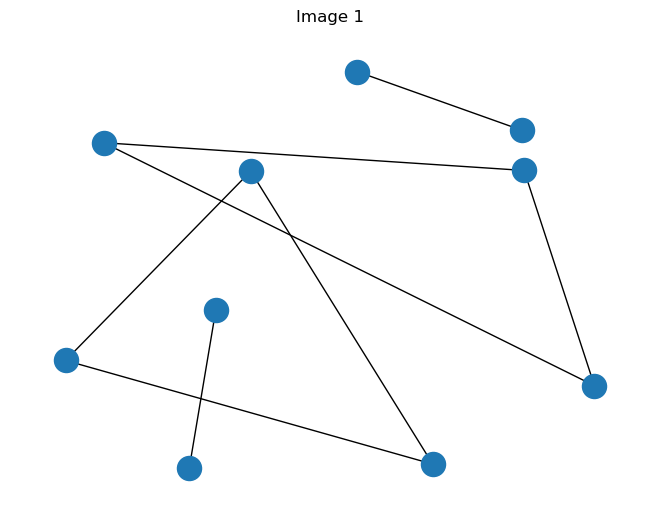

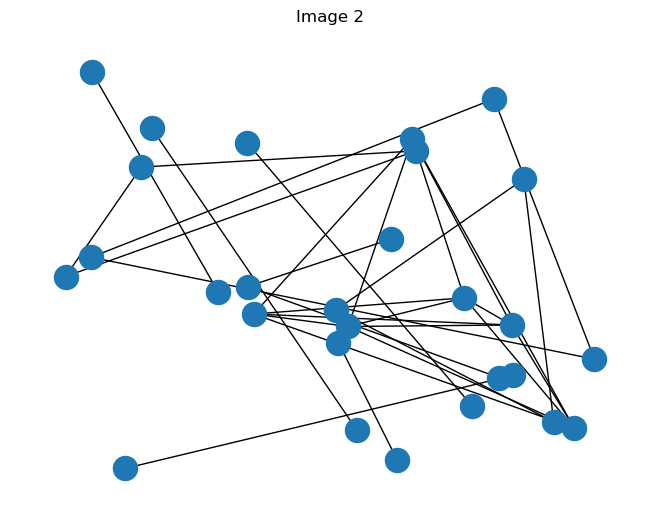

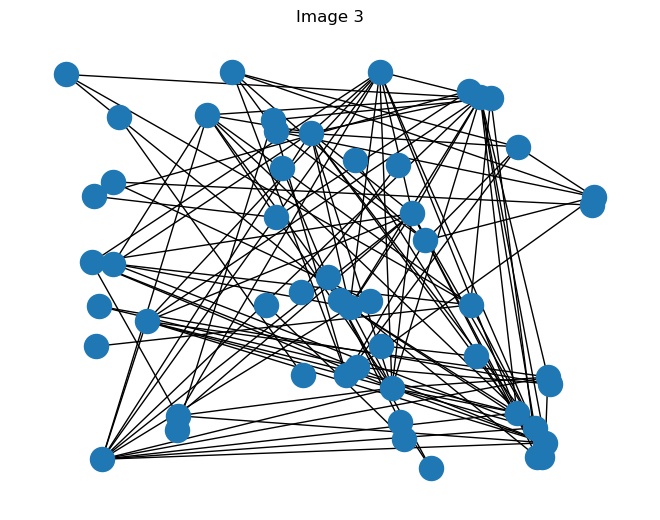

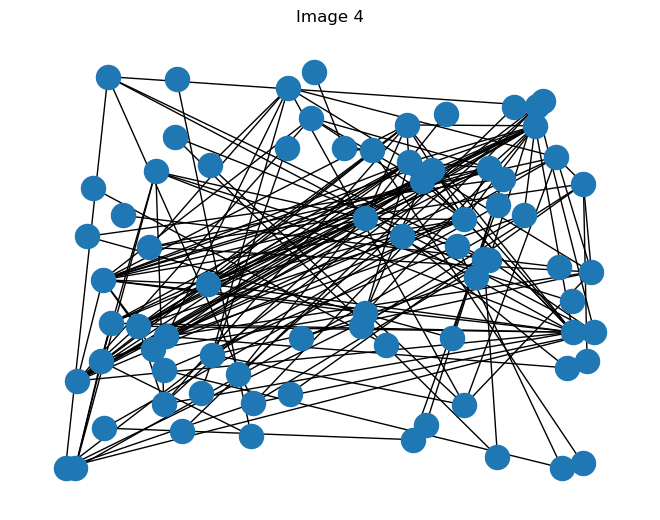

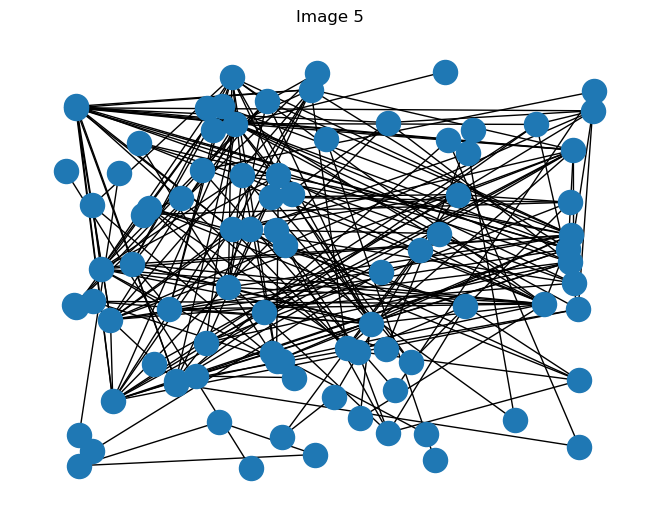

...

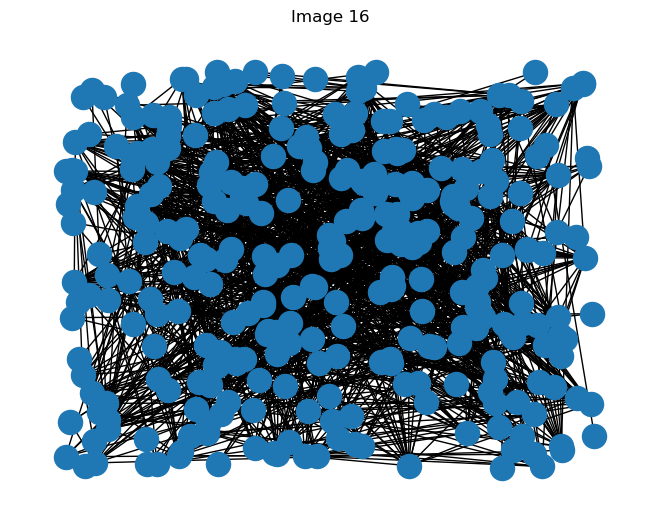

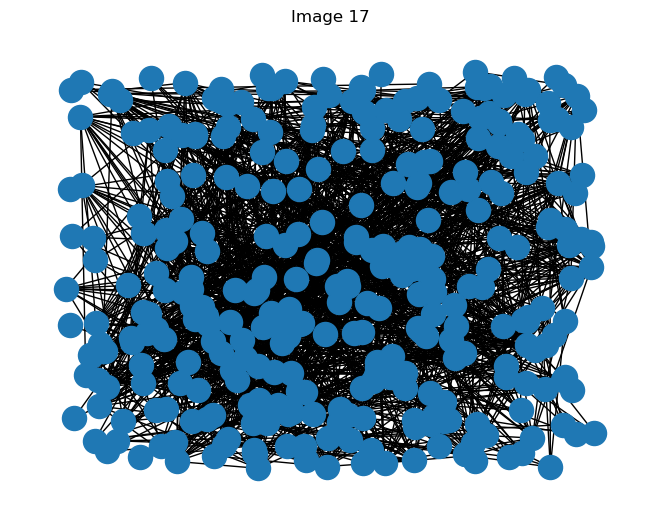

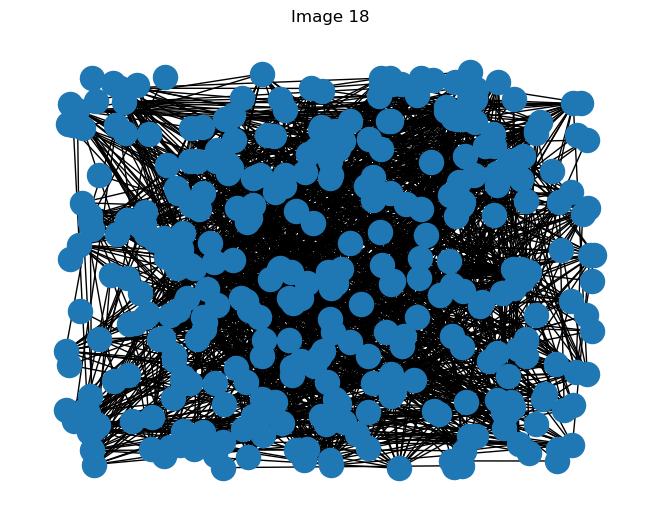

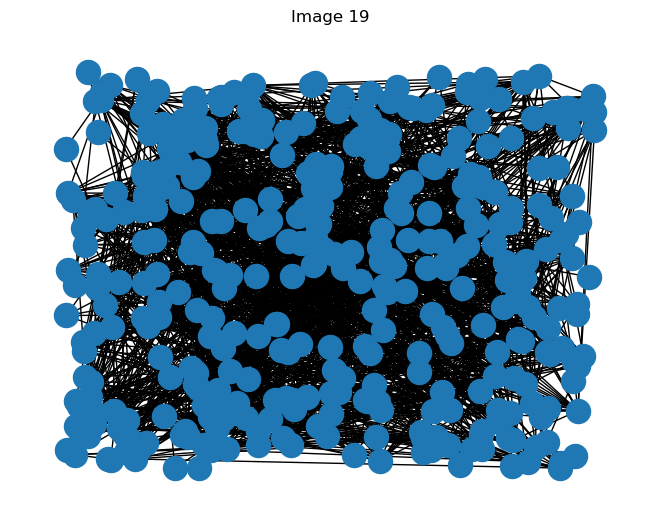

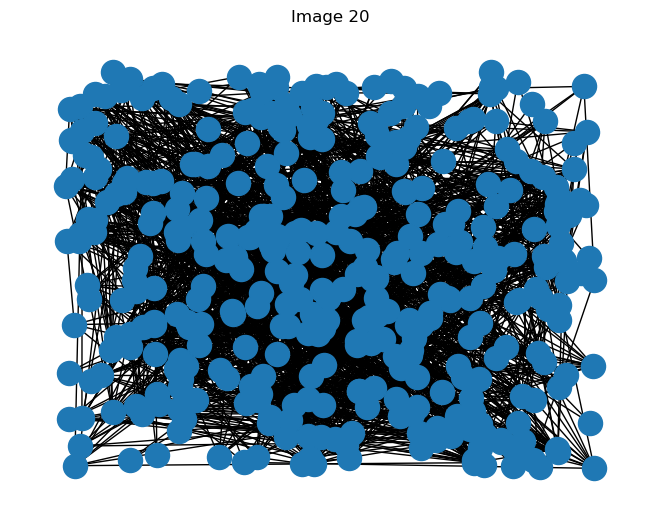

In [73]:
l1 = np.array(l1).reshape((len(l1), 4))
for k in range(1,21): 
    for i in range(k*25):
        for j in range(i+1,k*25):
            if((l1[j][3] - l1[i][3]) < mean_ts):
                isInfected_1[i] = 1
                break
    adj = [[0 for j in range(500)] for i in range(500)]
    G = nx.Graph()
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(Similarity_1[i][j]>=mean_similarity and isInfected_1[i]==1):
                adj[i][j] = 1
                G.add_edge(i, j)
    Sus=k*25
    Inf=0
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(adj[i][j]==1):
                Sus-=1
                break
    Inf=k*25-Sus
    ans1.append((Sus,Inf))
    nx.draw_random(G)
    plt.title('Image '+str(k))
    plt.show()

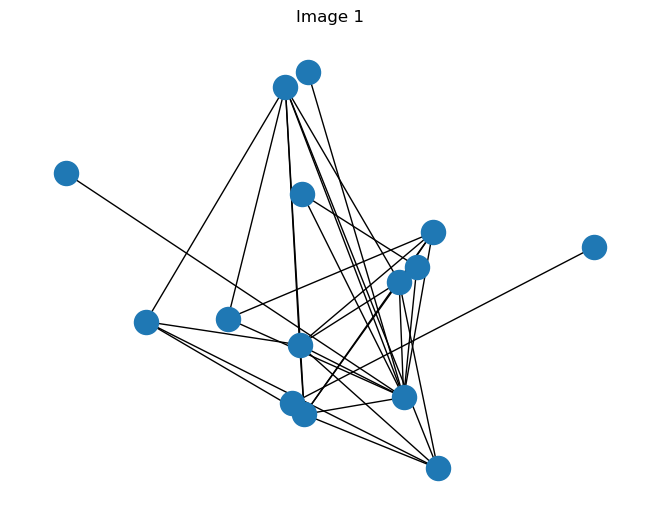

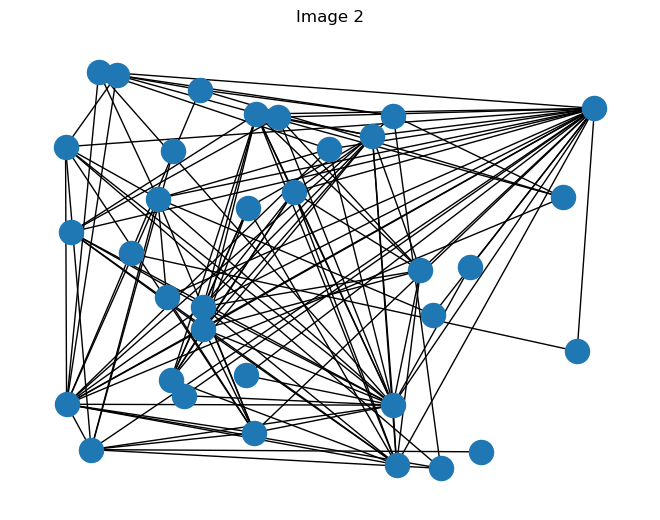

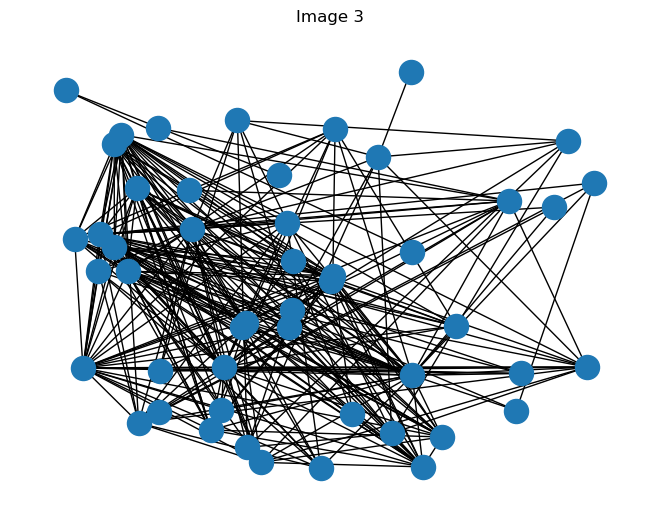

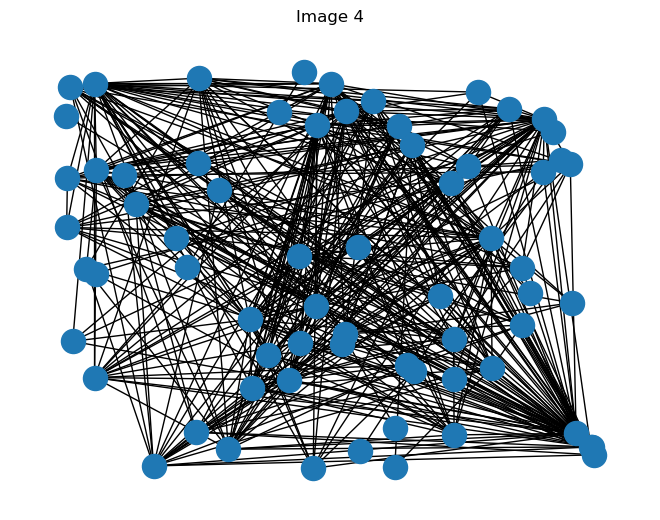

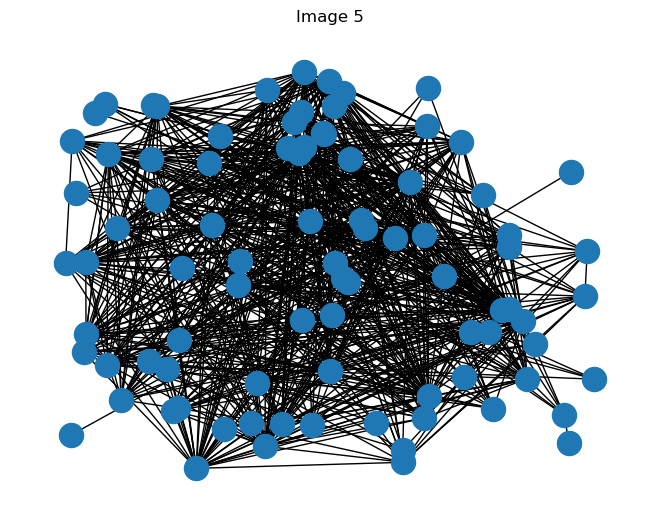

...

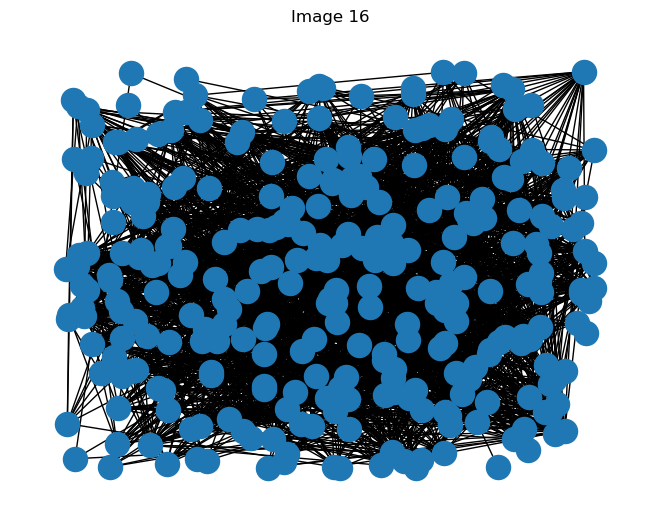

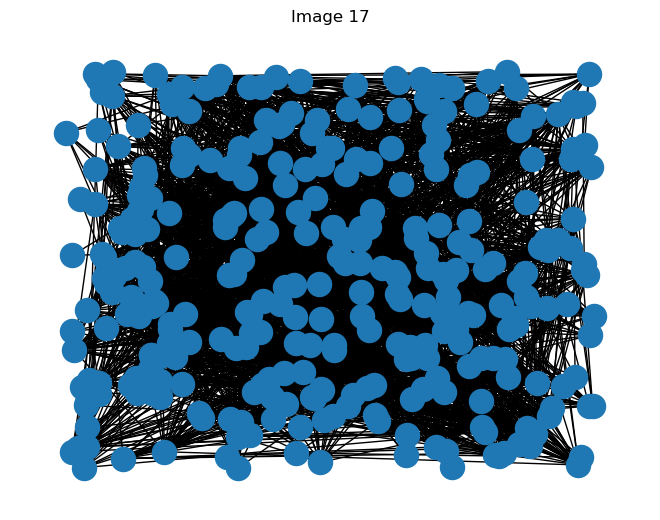

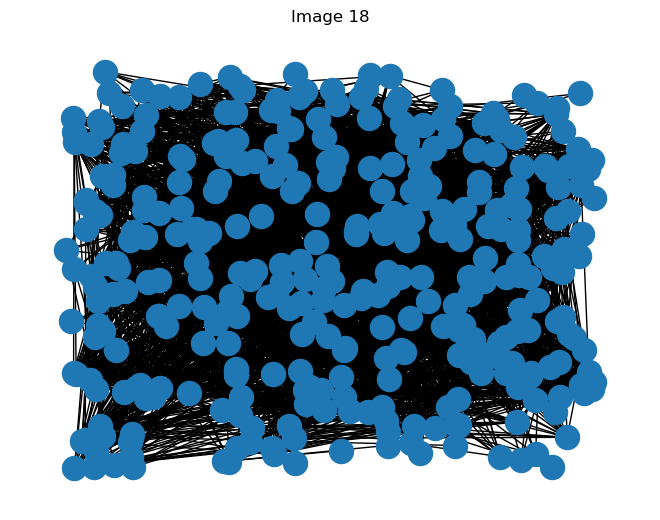

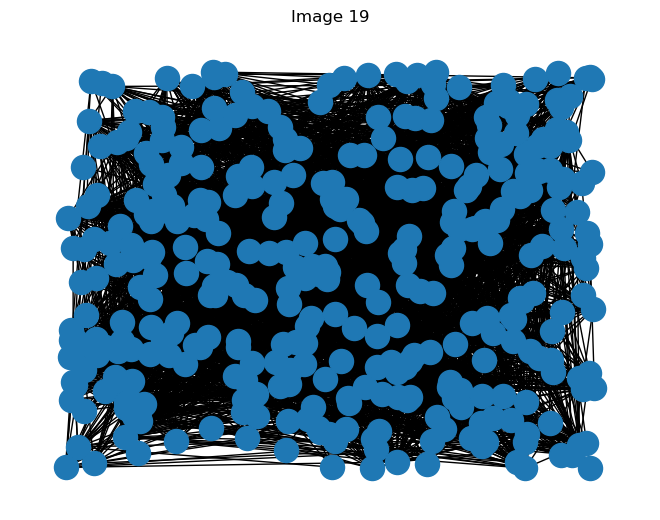

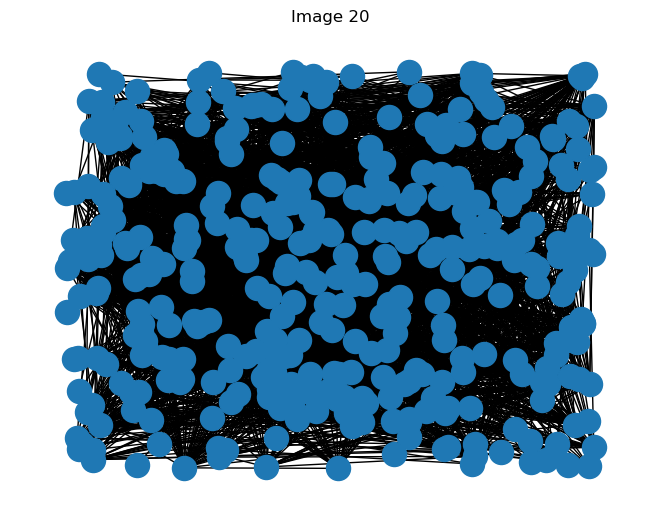

In [74]:
l2 = np.array(l2).reshape((len(l2), 4))
for k in range(1,21): 
    for i in range(k*25):
        for j in range(i+1,k*25):
            if((l2[j][3] - l2[i][3]) < mean_ts):
                isInfected_2[i] = 1
                break
    adj = [[0 for j in range(500)] for i in range(500)]
    G = nx.Graph()
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(Similarity_2[i][j]>=mean_similarity and isInfected_2[i]==1):
                adj[i][j] = 1
                G.add_edge(i, j)
    Sus=k*25
    Inf=0
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(adj[i][j]==1):
                Sus-=1
                break
    Inf=k*25-Sus
    ans2.append((Sus,Inf))
    nx.draw_random(G)
    plt.title('Image '+str(k))
    plt.show()

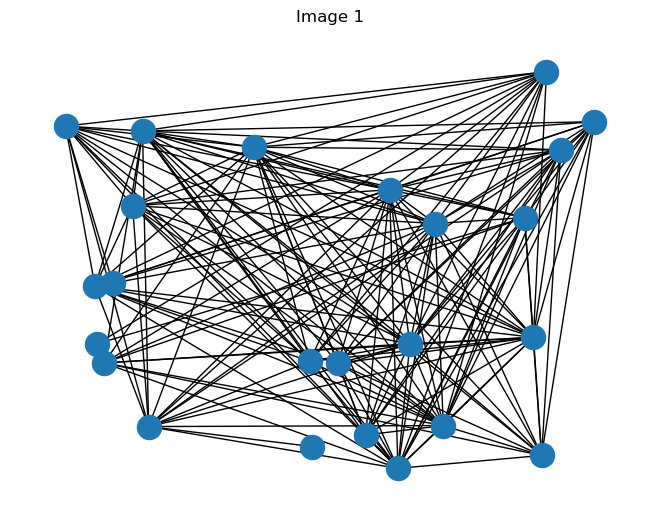

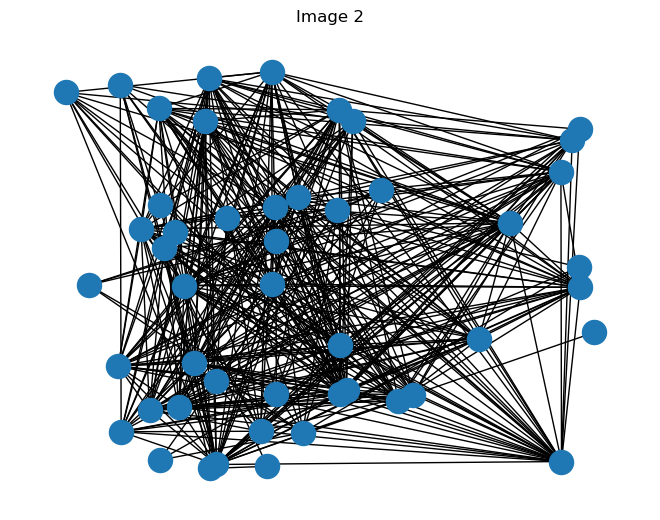

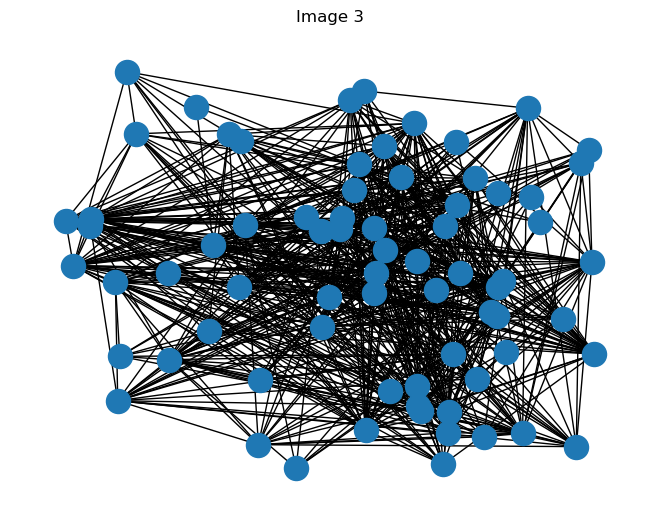

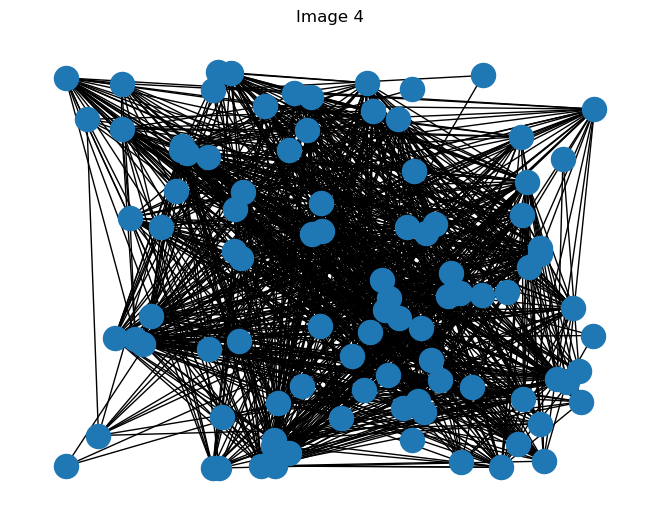

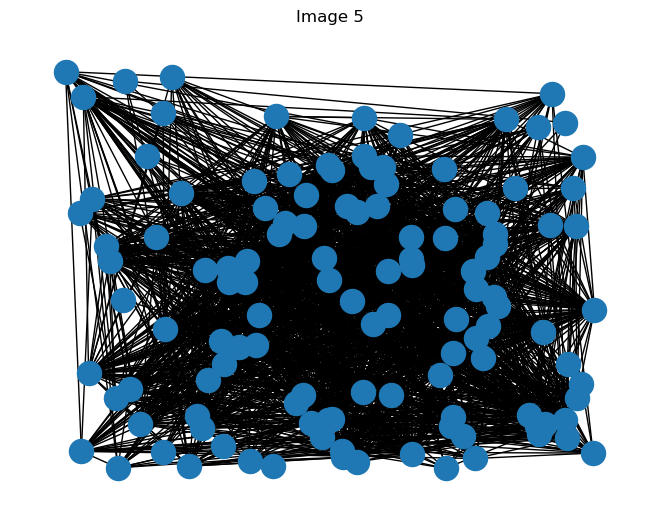

...

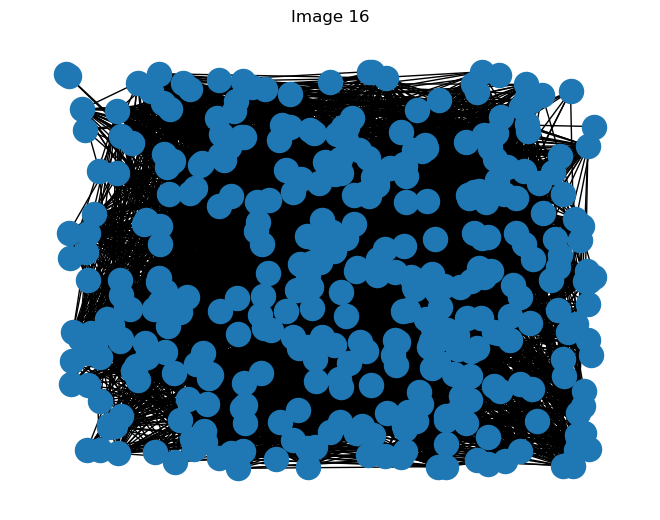

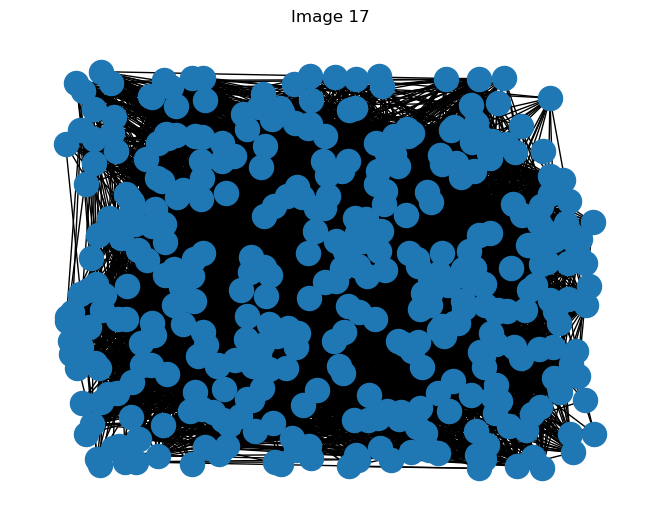

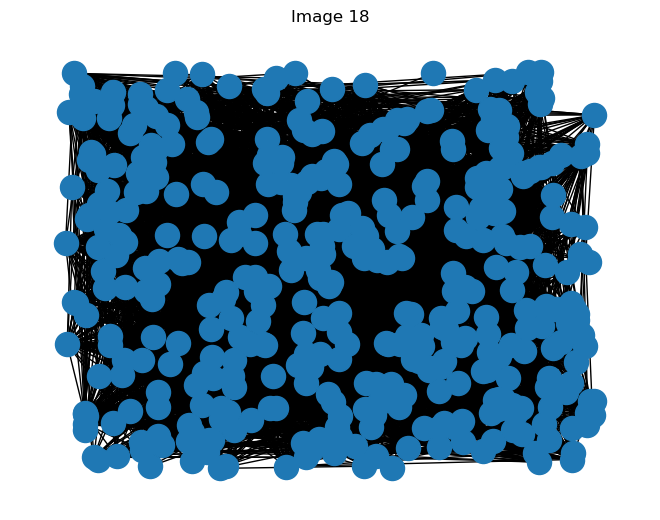

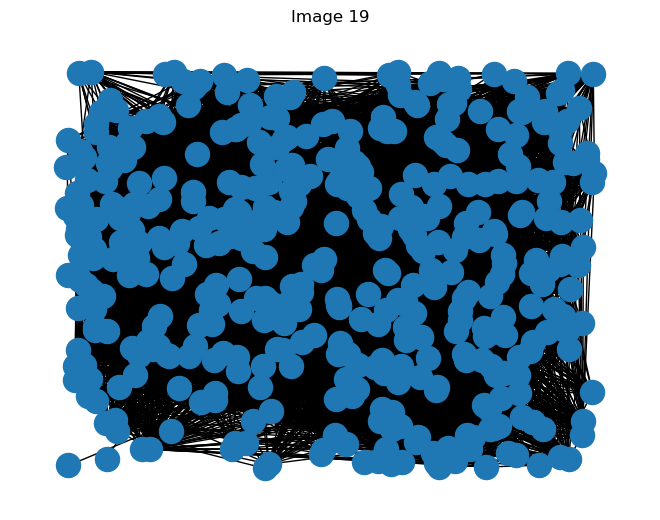

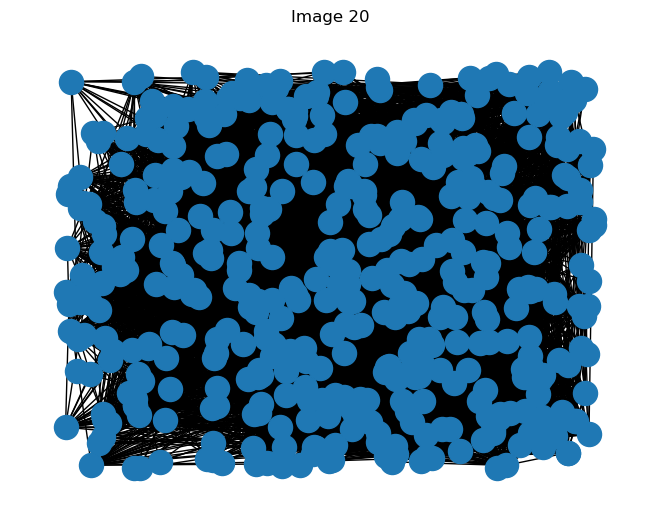

In [75]:
l3 = np.array(l3).reshape((len(l3), 4))
for k in range(1,21): 
    for i in range(k*25):
        for j in range(i+1,k*25):
            if((l3[j][3] - l3[i][3]) < mean_ts):
                isInfected_3[i] = 1
                break
    adj = [[0 for j in range(500)] for i in range(500)]
    G = nx.Graph()
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(Similarity_3[i][j]>=mean_similarity and isInfected_3[i]==1):
                adj[i][j] = 1
                G.add_edge(i, j)
    Sus=k*25
    Inf=0
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(adj[i][j]==1):
                Sus-=1
                break
    Inf=k*25-Sus
    ans3.append((Sus,Inf))
    nx.draw_random(G)
    plt.title('Image '+str(k))
    plt.show()

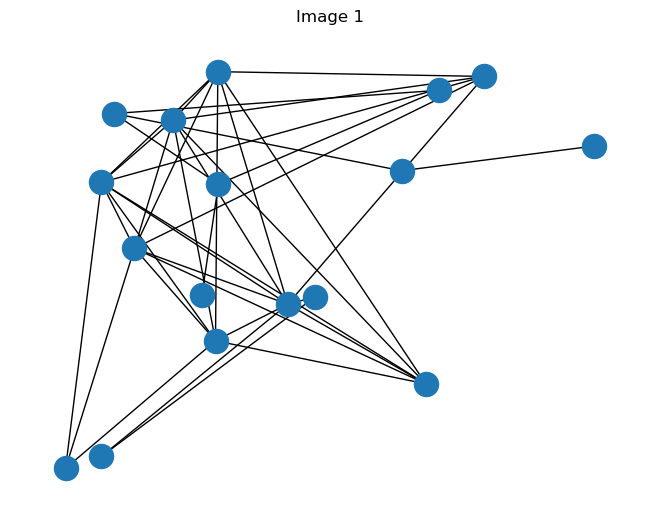

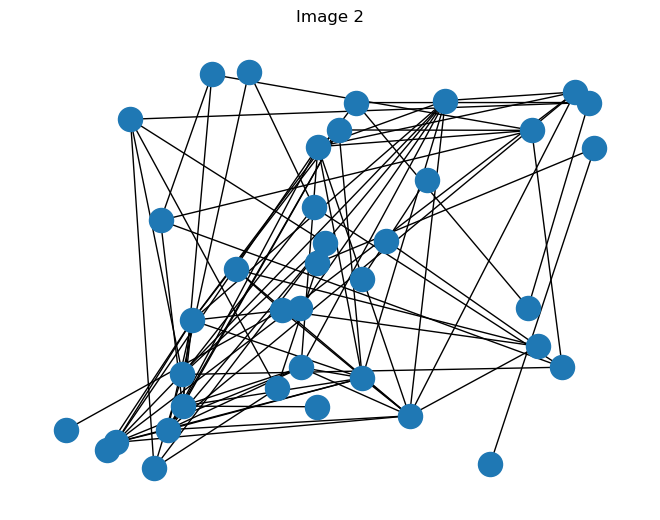

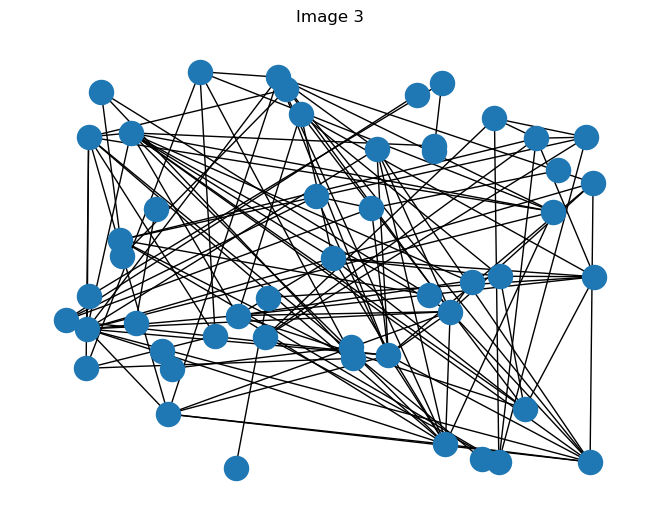

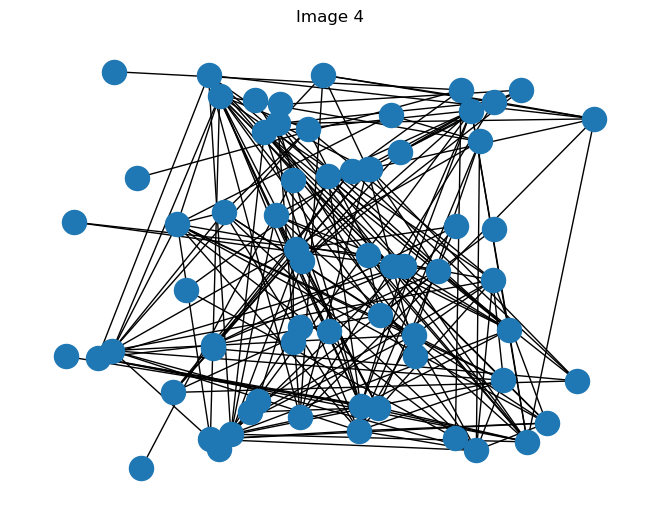

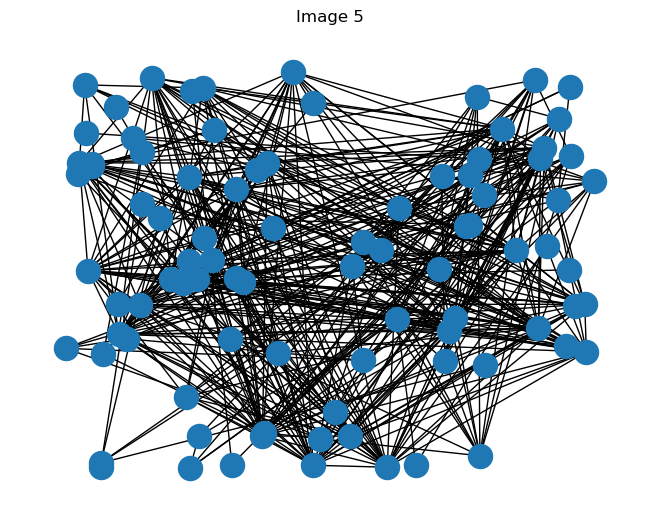

...

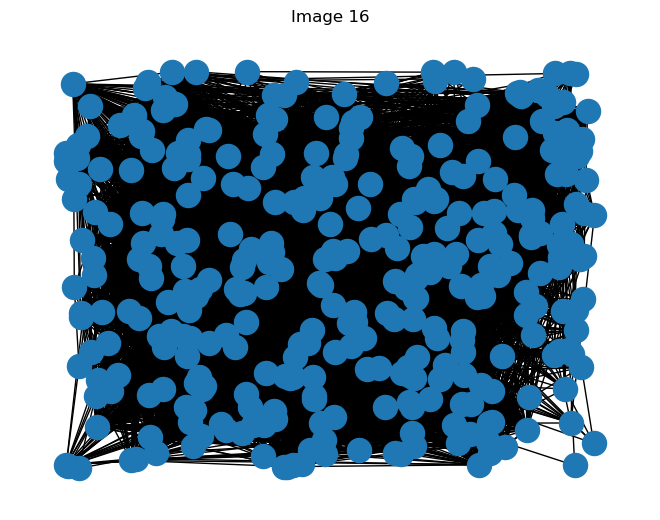

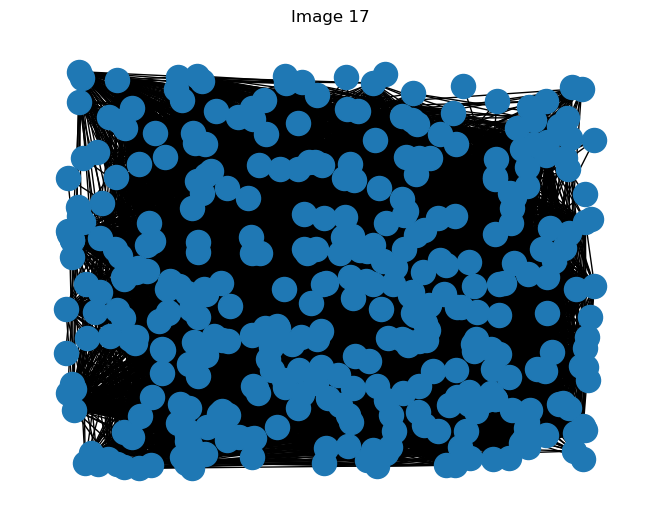

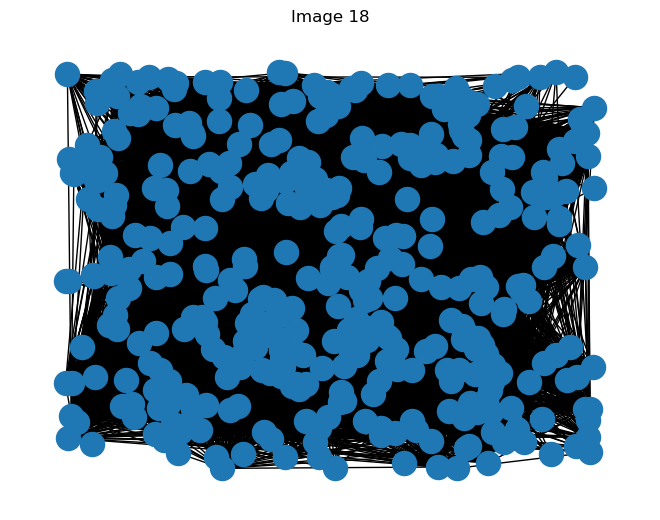

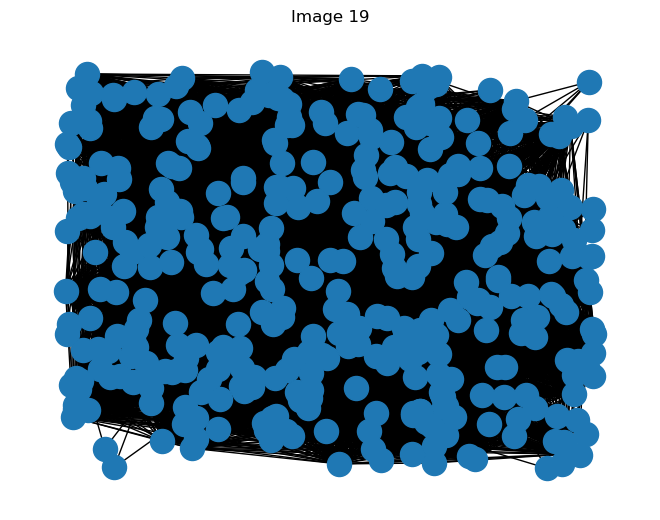

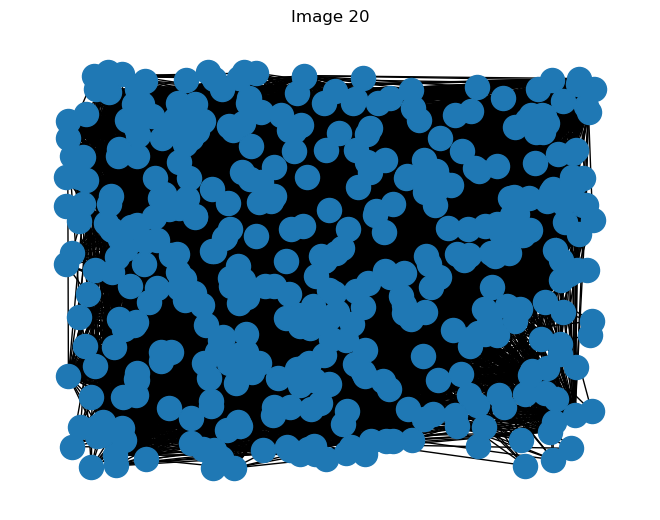

In [76]:
l4 = np.array(l4).reshape((len(l4), 4))
for k in range(1,21): 
    for i in range(k*25):
        for j in range(i+1,k*25):
            if((l4[j][3] - l4[i][3]) < mean_ts):
                isInfected_4[i] = 1
                break
    adj = [[0 for j in range(500)] for i in range(500)]
    G = nx.Graph()
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(Similarity_4[i][j]>=mean_similarity and isInfected_4[i]==1):
                adj[i][j] = 1
                G.add_edge(i, j)
    Sus=k*25
    Inf=0
    for i in range(k*25):
        for j in range(i+1,k*25):
            if(adj[i][j]==1):
                Sus-=1
                break
    Inf=k*25-Sus
    ans4.append((Sus,Inf))
    nx.draw_random(G)
    plt.title('Image '+str(k))
    plt.show()

In [77]:
ans1

[(24, 1),
 (19, 6),
 (33, 17),
 (38, 37),
 (48, 52),
 (64, 61),
 (76, 74),
 (89, 86),
 (96, 104),
 (102, 123),
 (108, 142),
 (113, 162),
 (115, 185),
 (131, 194),
 (133, 217),
 (148, 227),
 (154, 246),
 (169, 256),
 (173, 277),
 (181, 294),
 (191, 309)]

In [78]:
ans2

[(24, 1),
 (14, 11),
 (23, 27),
 (31, 44),
 (42, 58),
 (50, 75),
 (62, 88),
 (70, 105),
 (85, 115),
 (92, 133),
 (97, 153),
 (106, 169),
 (118, 182),
 (126, 199),
 (141, 209),
 (151, 224),
 (153, 247),
 (155, 270),
 (157, 293),
 (162, 313),
 (166, 334)]

In [79]:
ans3

[(24, 1),
 (3, 22),
 (8, 42),
 (12, 63),
 (13, 87),
 (16, 109),
 (16, 134),
 (33, 142),
 (44, 156),
 (45, 180),
 (49, 201),
 (52, 223),
 (56, 244),
 (61, 264),
 (68, 282),
 (76, 299),
 (68, 332),
 (78, 347),
 (83, 367),
 (86, 389),
 (80, 420)]

In [80]:
ans4

[(24, 1),
 (12, 13),
 (22, 28),
 (41, 34),
 (53, 47),
 (58, 67),
 (70, 80),
 (74, 101),
 (74, 126),
 (86, 139),
 (95, 155),
 (97, 178),
 (98, 202),
 (98, 227),
 (101, 249),
 (99, 276),
 (98, 302),
 (102, 323),
 (114, 336),
 (128, 347),
 (143, 357)]

In [81]:
Susceptible_1 = []
Infectious_1 = []
for i in range(0,21):
    if (i==0):
        Susceptible_1.append(((ans1[0][0])/(25))*100)
        Infectious_1.append((ans1[0][1]/(25))*100)
    else:
        Susceptible_1.append(((ans1[i][0])/(25*i))*100)
        Infectious_1.append((ans1[i][1]/(25*i))*100)

In [82]:
Susceptible_2 = []
Infectious_2 = []
for i in range(0,21):
    if (i==0):
        Susceptible_2.append(((ans2[0][0])/(25))*100)
        Infectious_2.append((ans2[0][1]/(25))*100)
    else:
        Susceptible_2.append(((ans2[i][0])/(25*i))*100)
        Infectious_2.append((ans2[i][1]/(25*i))*100)

In [83]:
Susceptible_3 = []
Infectious_3 = []
for i in range(0,21):
    if (i==0):
        Susceptible_3.append(((ans3[0][0])/(25))*100)
        Infectious_3.append((ans3[0][1]/(25))*100)
    else:
        Susceptible_3.append(((ans3[i][0])/(25*i))*100)
        Infectious_3.append((ans3[i][1]/(25*i))*100)

In [84]:
Susceptible_4 = []
Infectious_4 = []
for i in range(0,21):
    if (i==0):
        Susceptible_4.append(((ans4[0][0])/(25))*100)
        Infectious_4.append(ans4[0][1]/(25))
    else:
        Susceptible_4.append(((ans4[i][0])/(25*i))*100)
        Infectious_4.append((ans4[i][1]/(25*i))*100)

In [85]:
print(Susceptible_1)
print ('\n')
print(Infectious_1)

[96.0, 76.0, 66.0, 50.66666666666667, 48.0, 51.2, 50.66666666666667, 50.857142857142854, 48.0, 45.33333333333333, 43.2, 41.090909090909086, 38.333333333333336, 40.30769230769231, 38.0, 39.46666666666667, 38.5, 39.76470588235294, 38.44444444444444, 38.10526315789474, 38.2]


[4.0, 24.0, 34.0, 49.333333333333336, 52.0, 48.8, 49.333333333333336, 49.142857142857146, 52.0, 54.666666666666664, 56.8, 58.909090909090914, 61.66666666666667, 59.692307692307686, 62.0, 60.53333333333333, 61.5, 60.23529411764705, 61.55555555555555, 61.89473684210526, 61.8]


In [86]:
print(Susceptible_2)
print('\n')
print(Infectious_2)

[96.0, 56.00000000000001, 46.0, 41.333333333333336, 42.0, 40.0, 41.333333333333336, 40.0, 42.5, 40.88888888888889, 38.800000000000004, 38.54545454545455, 39.33333333333333, 38.76923076923077, 40.285714285714285, 40.266666666666666, 38.25, 36.470588235294116, 34.88888888888889, 34.10526315789474, 33.2]


[4.0, 44.0, 54.0, 58.666666666666664, 57.99999999999999, 60.0, 58.666666666666664, 60.0, 57.49999999999999, 59.111111111111114, 61.199999999999996, 61.45454545454545, 60.66666666666667, 61.23076923076923, 59.71428571428572, 59.73333333333334, 61.75000000000001, 63.52941176470588, 65.11111111111111, 65.89473684210526, 66.8]


In [87]:
print(Susceptible_3)
print('\n')
print(Infectious_3)

[96.0, 12.0, 16.0, 16.0, 13.0, 12.8, 10.666666666666668, 18.857142857142858, 22.0, 20.0, 19.6, 18.90909090909091, 18.666666666666668, 18.76923076923077, 19.428571428571427, 20.266666666666666, 17.0, 18.352941176470587, 18.444444444444443, 18.10526315789474, 16.0]


[4.0, 88.0, 84.0, 84.0, 87.0, 87.2, 89.33333333333333, 81.14285714285714, 78.0, 80.0, 80.4, 81.0909090909091, 81.33333333333333, 81.23076923076923, 80.57142857142857, 79.73333333333333, 83.0, 81.64705882352942, 81.55555555555556, 81.89473684210526, 84.0]


In [88]:
print(Susceptible_4)
print('\n')
print(Infectious_4)

[96.0, 48.0, 44.0, 54.666666666666664, 53.0, 46.400000000000006, 46.666666666666664, 42.285714285714285, 37.0, 38.22222222222222, 38.0, 35.27272727272727, 32.666666666666664, 30.153846153846153, 28.857142857142858, 26.400000000000002, 24.5, 24.0, 25.333333333333336, 26.94736842105263, 28.599999999999998]


[0.04, 52.0, 56.00000000000001, 45.33333333333333, 47.0, 53.6, 53.333333333333336, 57.714285714285715, 63.0, 61.77777777777778, 62.0, 64.72727272727272, 67.33333333333333, 69.84615384615384, 71.14285714285714, 73.6, 75.5, 76.0, 74.66666666666667, 73.05263157894737, 71.39999999999999]


In [89]:
Time_line = np.arange(1, 22, 1)
Time_line

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21])

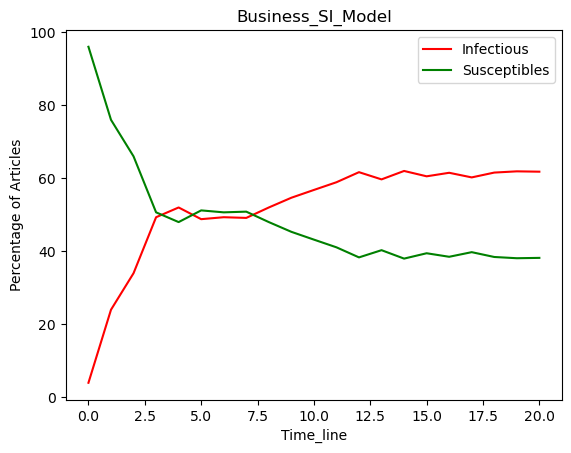

In [90]:
pl.plot(Infectious_1, '-r', label='Infectious')  
pl.plot(Susceptible_1, '-g', label='Susceptibles')
pl.legend(loc=0)
pl.xlabel('Time_line')
pl.ylabel('Percentage of Articles')
pl.title('Business_SI_Model')
plt.show()

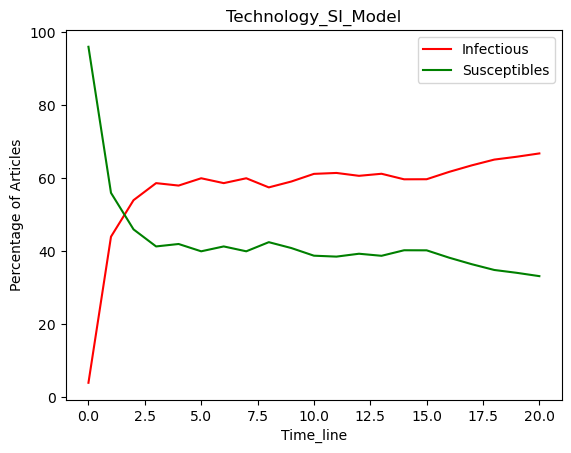

In [91]:
pl.plot(Infectious_2, '-r', label='Infectious')  
pl.plot(Susceptible_2, '-g', label='Susceptibles')
pl.legend(loc=0)
pl.xlabel('Time_line')
pl.ylabel('Percentage of Articles')
pl.title('Technology_SI_Model')
plt.show()

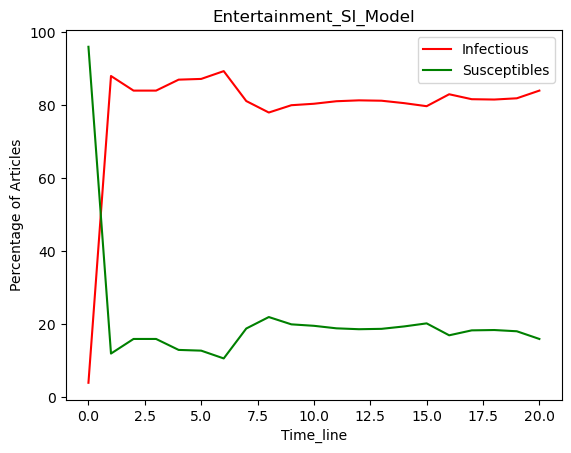

In [92]:
pl.plot(Infectious_3, '-r', label='Infectious')  
pl.plot(Susceptible_3, '-g', label='Susceptibles')
pl.legend(loc=0)
pl.xlabel('Time_line')
pl.ylabel('Percentage of Articles')
pl.title('Entertainment_SI_Model')
plt.show()

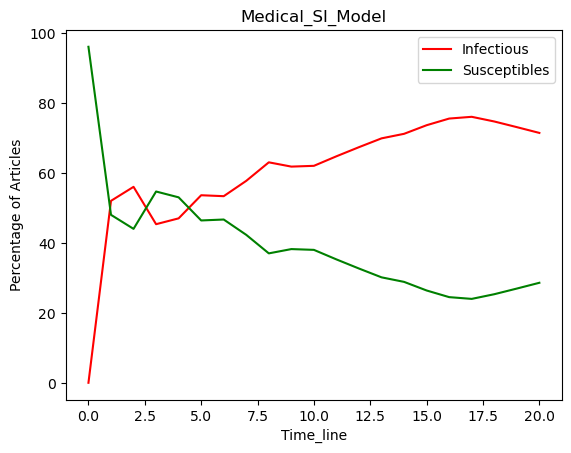

In [93]:
pl.plot(Infectious_4, '-r', label='Infectious')  
pl.plot(Susceptible_4, '-g', label='Susceptibles')
pl.legend(loc=0)
pl.xlabel('Time_line')
pl.ylabel('Percentage of Articles')
pl.title('Medical_SI_Model')
plt.show()

In [94]:
new_arr = []
def diff_eqs(INP,t):  
    '''''The main set of equations'''  
    Y=np.zeros((2))  
    V = INP  
    Y[0] = - beta * V[0] * V[1]  
    Y[1] = beta * V[0] * V[1]
    new_arr.append((Y[0], Y[1]))
    # Y[2] = gamma * V[1]  
    return Y   # For odeint 

In [95]:
beta=0.003
# gamma=0.1  
TS=1.0  
ND=50.0  
INPUT = (499, 1)

In [96]:
t_start = 0.0; t_end = ND; t_inc = TS  
t_range = np.arange(t_start, t_end+t_inc, t_inc)  
RES = spi.odeint(diff_eqs,INPUT,t_range)

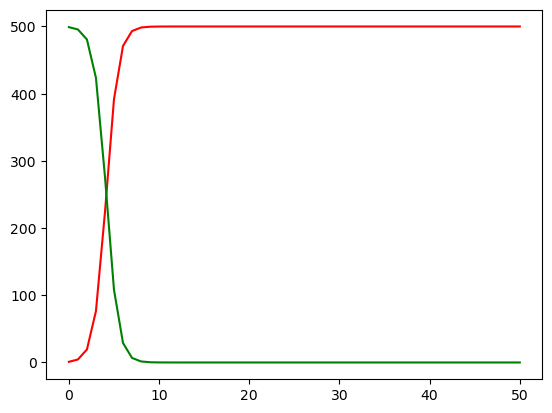

In [97]:
pl.subplot(111)  
pl.plot(RES[:,1], '-r', label='Infectious')  
pl.plot(RES[:,0], '-g', label='Susceptibles')

In [98]:
len(Infectious_1)

21

In [99]:
Business_Infectious_rate = []
Business_Susceptible_rate = []
for i in range(0,20):
    Business_Infectious_rate.append(Infectious_1[i+1]-Infectious_1[i])
    Business_Susceptible_rate.append(Susceptible_1[i+1]-Susceptible_1[i])

In [100]:
Technology_Infectious_rate = []
Technology_Susceptible_rate = []
for i in range(0,20):
    Technology_Infectious_rate.append(Infectious_2[i+1]-Infectious_2[i])
    Technology_Susceptible_rate.append(Susceptible_2[i+1]-Susceptible_2[i])

In [101]:
Entertainment_Infectious_rate = []
Entertainment_Susceptible_rate = []
for i in range(0,20):
    Entertainment_Infectious_rate.append(Infectious_3[i+1]-Infectious_3[i])
    Entertainment_Susceptible_rate.append(Susceptible_3[i+1]-Susceptible_3[i])

In [102]:
Medical_Infectious_rate = []
Medical_Susceptible_rate = []
for i in range(0,20):
    Medical_Infectious_rate.append(Infectious_4[i+1]-Infectious_4[i])
    Medical_Susceptible_rate.append(Susceptible_4[i+1]-Susceptible_4[i])

In [103]:
Time_line_2 = np.arange(1, 21, 1)
Time_line_2

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20])

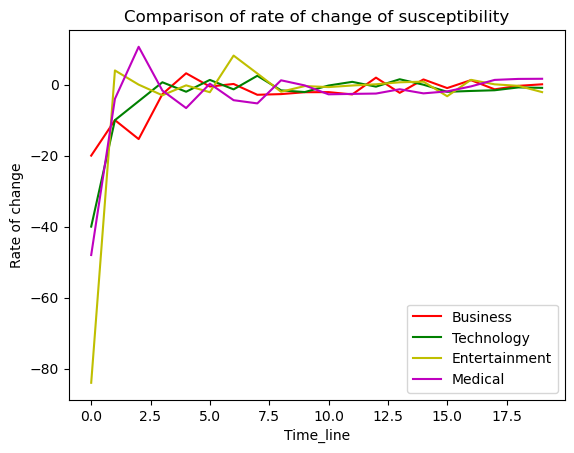

In [104]:
pl.plot(Business_Susceptible_rate, '-r', label='Business')  
pl.plot(Technology_Susceptible_rate, '-g', label='Technology')
pl.plot(Entertainment_Susceptible_rate, '-y', label='Entertainment')  
pl.plot(Medical_Susceptible_rate, '-m', label='Medical')
pl.legend(loc=0)
pl.xlabel('Time_line')
pl.ylabel('Rate of change')
pl.title('Comparison of rate of change of susceptibility')
plt.show()

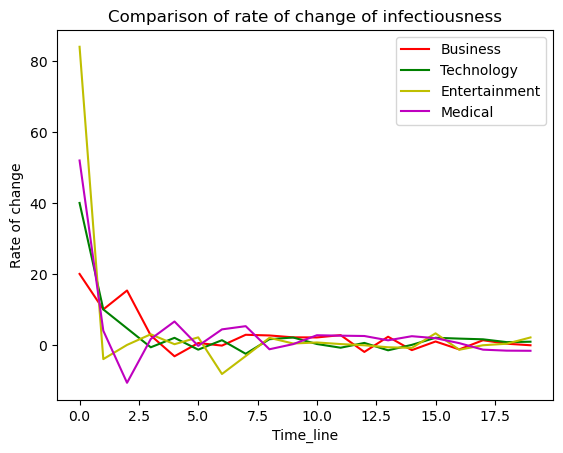

In [105]:
pl.plot(Business_Infectious_rate, '-r', label='Business')  
pl.plot(Technology_Infectious_rate, '-g', label='Technology')
pl.plot(Entertainment_Infectious_rate, '-y', label='Entertainment')  
pl.plot(Medical_Infectious_rate, '-m', label='Medical')
pl.legend(loc=0)
pl.xlabel('Time_line')
pl.ylabel('Rate of change')
pl.title('Comparison of rate of change of infectiousness')
plt.show()